In [21]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy.io import wavfile
from IPython.display import Audio
from scipy import fft
import librosa
import librosa.display
from wavinfo import WavInfoReader
import pandas as pd
import os

In [37]:
pwd = os.path.abspath('.')
loc = os.path.join(pwd, '..', 'raw_data', 'groove')
# loc_ = '../raw_data/groove/info.csv'
loc

'/Users/HZB/code/vickoru/drumbeatid/notebooks/../raw_data/groove'

In [38]:
df_drummers = pd.read_csv(os.path.join(loc, 'info.csv'))
df_drummers.sample(10)

,drummer,session,id,style,bpm,beat_type,time_signature,midi_filename,audio_filename,duration,split
404,drummer1,drummer1/session2,drummer1/session2/34,punk,128,beat,4-4,drummer1/session2/34_punk_128_beat_4-4.mid,drummer1/session2/34_punk_128_beat_4-4.wav,7.115234,train
190,drummer1,drummer1/session1,drummer1/session1/261,funk/purdieshuffle,130,fill,4-4,drummer1/session1/261_funk-purdieshuffle_130_f...,drummer1/session1/261_funk-purdieshuffle_130_f...,1.494229,validation
961,drummer7,drummer7/session3,drummer7/session3/42,rock/indie,63,fill,4-4,drummer7/session3/42_rock-indie_63_fill_4-4.mid,drummer7/session3/42_rock-indie_63_fill_4-4.wav,3.438492,train
618,drummer5,drummer5/eval_session,drummer5/eval_session/5,funk/groove5,84,beat,4-4,drummer5/eval_session/5_funk-groove5_84_beat_4...,drummer5/eval_session/5_funk-groove5_84_beat_4...,45.645852,test
944,drummer7,drummer7/session3,drummer7/session3/27,hiphop,67,fill,4-4,drummer7/session3/27_hiphop_67_fill_4-4.mid,drummer7/session3/27_hiphop_67_fill_4-4.wav,3.535446,train
581,drummer3,drummer3/session2,drummer3/session2/32,hiphop,92,beat,4-4,drummer3/session2/32_hiphop_92_beat_4-4.mid,drummer3/session2/32_hiphop_92_beat_4-4.wav,10.376360,train
759,drummer7,drummer7/session2,drummer7/session2/123,hiphop,140,beat,4-4,drummer7/session2/123_hiphop_140_beat_4-4.mid,drummer7/session2/123_hiphop_140_beat_4-4.wav,109.976676,train
177,drummer1,drummer1/session1,drummer1/session1/25,jazz/funk,116,fill,4-4,drummer1/session1/25_jazz-funk_116_fill_4-4.mid,drummer1/session1/25_jazz-funk_116_fill_4-4.wav,2.012930,train
8,drummer1,drummer1/eval_session,drummer1/eval_session/8,rock/groove8,65,beat,4-4,drummer1/eval_session/8_rock-groove8_65_beat_4...,drummer1/eval_session/8_rock-groove8_65_beat_4...,59.067313,test
75,drummer1,drummer1/session1,drummer1/session1/158,latin/brazilian-baiao,95,fill,4-4,drummer1/session1/158_latin-brazilian-baiao_95...,drummer1/session1/158_latin-brazilian-baiao_95...,2.294733,train


In [40]:
df_drummers['style'].unique()

array(['funk/groove1', 'soul/groove10', 'funk/groove2', 'soul/groove3',
       'soul/groove4', 'funk/groove5', 'hiphop/groove6', 'pop/groove7',
       'rock/groove8', 'soul/groove9', 'funk', 'jazz/funk',
       'neworleans/secondline', 'dance/disco', 'funk/fast',
       'latin/brazilian-baiao', 'afrocuban', 'reggae', 'reggae/slow',
       'rock/halftime', 'funk/purdieshuffle', 'latin/samba', 'jazz',
       'rock/shuffle', 'jazz/mediumfast', 'jazz/fast', 'latin/reggaeton',
       'dance/breakbeat', 'neworleans/funk', 'latin/chacarera', 'country',
       'funk/rock', 'rock/prog', 'afrocuban/bembe', 'gospel',
       'afrocuban/rhumba', 'rock', 'punk', 'jazz/march', 'rock/folk',
       'afrobeat', 'latin/bomba', 'afrocuban/calypso', 'jazz/swing',
       'rock/rockabilly', 'jazz/linear', 'hiphop', 'jazz/klezmer',
       'latin/brazilian', 'blues/shuffle', 'latin/merengue',
       'latin/brazilian-bossa', 'latin/brazilian-sambareggae',
       'latin/brazilian-songo', 'middleeastern', 'latin/

In [41]:
drumbeat = df_drummers.loc[759, 'audio_filename']
wavFile = os.path.join(loc, drumbeat)
# wavFile = loc_ + drumbeat
wavFile

'/Users/HZB/code/vickoru/drumbeatid/notebooks/../raw_data/groove/drummer7/session2/123_hiphop_140_beat_4-4.wav'

In [42]:
y, sr = librosa.load(wavFile)

In [44]:
y, sr

(array([ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00, ...,
        -4.9928343e-04,  7.1120521e-06,  4.0293275e-04], dtype=float32),
 22050)

In [45]:
Audio(wavFile)

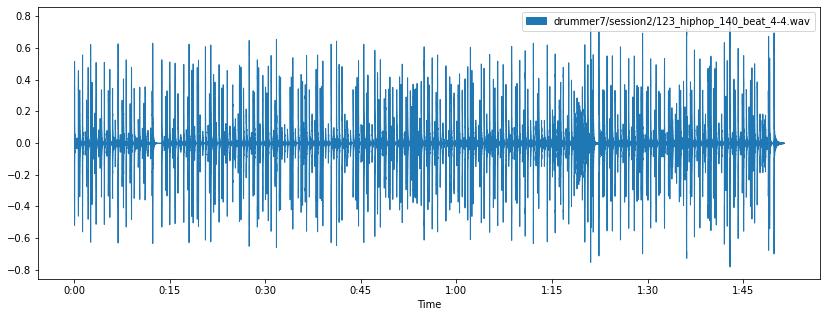

In [46]:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y, sr=sr, label=drumbeat)
plt.legend()
plt.savefig('waveform.png')

In [47]:
scipy_sample_rate, scipy_audio = wavfile.read(wavFile)


/var/folders/jw/d43bpk916bz864ddr7_d7nqh0000gp/T/ipykernel_2212/1519479978.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  scipy_sample_rate, scipy_audio = wavfile.read(wavFile)


In [48]:
print(f"Original sample rate: {scipy_sample_rate}")
print(f"Librosa sample rate: {sr}")

Original sample rate: 44100
Librosa sample rate: 22050


In [49]:
print(f'Original audio file min~max range: {np.min(scipy_audio)} to {np.max(scipy_audio)}')
print('Librosa audio file min~max range: {0:.2f} to {0:.2f}'.format(np.min(y), np.max(y)))

Original audio file min~max range: -32392 to 27382
Librosa audio file min~max range: -0.78 to -0.78


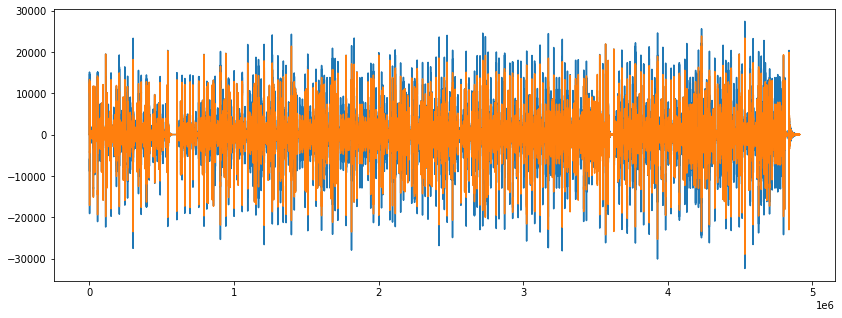

In [50]:
plt.figure(figsize=(14, 5))
plt.plot(scipy_audio)

## Features 
### Mel Frequency Cepstral Coefficients (MFCCS) 

In [53]:
def calculate_mfccs(waveform, samplingrate, number_coeffs=20):
    '''
    Caluculate Mel frequency cepstral coefficients.
    Input: 
    waveform: array representing the waveform originating from audio file
    samplingrate: sampling rate from audio
    number_coeffs: total number of coefficients to calculate, default is 20
    Output: array of mfccs
    '''
    mfccs = librosa.feature.mfcc(y=waveform, sr=samplingrate, n_mfcc=number_coeffs)
    return mfccs

In [51]:
coeffs_number = 20
mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=coeffs_number)

In [52]:
mfccs.shape

(20, 4799)

In [58]:
calculate_mfccs(y, sr, coeffs_number).shape

(20, 4799)

In [60]:
np.all(calculate_mfccs(y, sr, coeffs_number) == mfccs)

True

### Zero crossing rate

In [ ]:
def calculate_mfccs(waveform, samplingrate, number_coeffs=20):
    '''
    Caluculate Mel frequency cepstral coefficients.
    Input: 
    waveform: array representing the waveform originating from audio file
    samplingrate: sampling rate from audio
    number_coeffs: total number of coefficients to calculate, default is 20
    Output: array of mfccs
    '''
    mfccs = librosa.feature.mfcc(y=waveform, sr=samplingrate, n_mfcc=number_coeffs)
    return mfccs

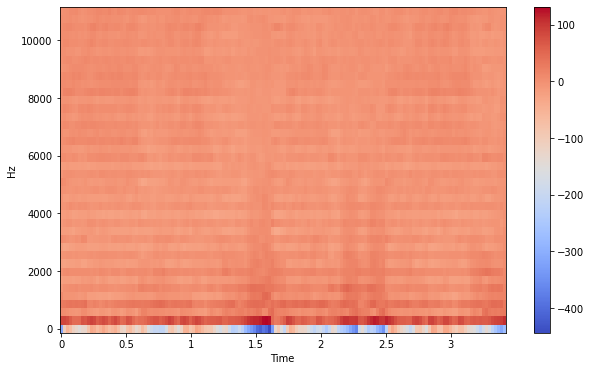

In [32]:
plt.figure(figsize=(10,6))
librosa.display.specshow(mfccs, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

In [33]:
n_fft = 2048
hop_length = 512

In [34]:
D = np.abs(librosa.stft(y, n_fft=n_fft, hop_length=hop_length))
D.shape

(1025, 148)

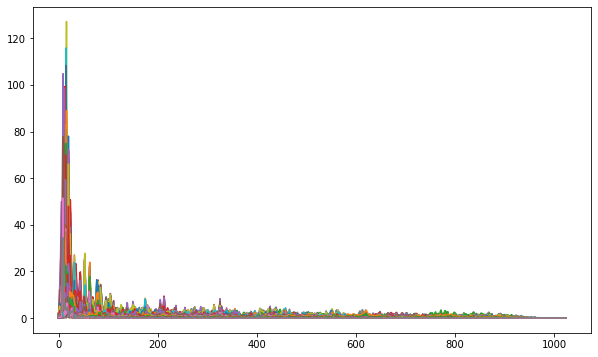

In [35]:
plt.figure(figsize=(10, 6))
plt.plot(D);

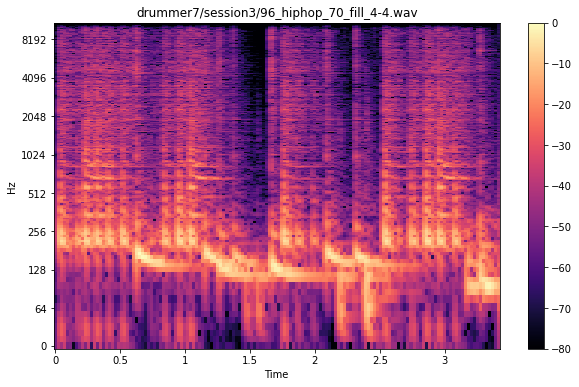

In [36]:
DB = librosa.amplitude_to_db(D, ref=np.max)
plt.figure(figsize=(10,6))
librosa.display.specshow(DB, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log')
plt.title(drumbeat)
plt.colorbar()
plt.savefig('spectrogram.png')

/var/folders/jw/d43bpk916bz864ddr7_d7nqh0000gp/T/ipykernel_33242/2624918385.py:1: FutureWarning: Pass y=[-0.0001658  -0.00026118 -0.00024087 ... -0.09626859 -0.09586104
 -0.10297781] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  S = librosa.feature.melspectrogram(y, sr=sr)


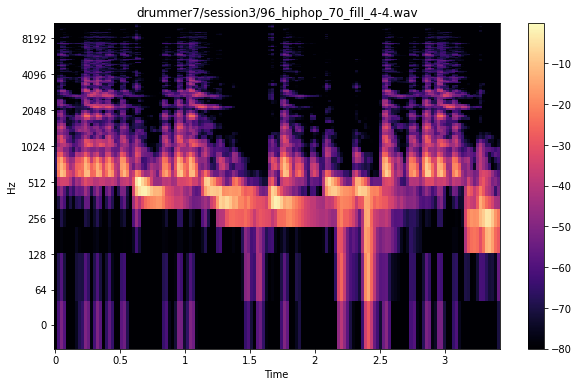

In [60]:
S = librosa.feature.melspectrogram(y, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(10,6))
librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log')
plt.title(drumbeat)
plt.colorbar()